In [97]:
import sys
KITTI_ROOT_PATH = '/home/ruizhu/Documents/Datasets/kitti'
sys.path.append(KITTI_ROOT_PATH+'/kitti-lidar-utils')
sys.path.append(KITTI_ROOT_PATH+'/kitti-lidar-utils/source')
sys.path.append(KITTI_ROOT_PATH+'/depth/devkit/python')

import numpy as np
np.set_printoptions(precision=4, suppress=True)

import itertools
import pdb
import os
from PIL import Image, ImageOps
import imageio
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import time
from source.utils import load_tracklets_for_frames, point_inside, in_hull
from source import parseTrackletXML as xmlParser
from source.kitti_util import *
import argparse
from matplotlib import cm
# from cluster_pcs.filters import *
from math import atan2, degrees
from PIL import Image
from read_depth import *
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

import torch

%reload_ext autoreload
%autoreload 2
from kitti_tools.utils_kitti import *
kitti_two_frame_loader = KittiLoader(KITTI_ROOT_PATH)

## Select sequence
date_name = '2011_09_26'
seq_name = '_drive_0005_sync'

kitti_two_frame_loader.set_drive(date_name, seq_name)
kitti_two_frame_loader.load_cam_poses()
# kitti_two_frame_loader.show_demo()
kitti_two_frame_loader.get_left_right_gt()

## Help functions and plot params
fig_scale = 300
fig_ratio = [4, 3]
im_shape = kitti_two_frame_loader.im_shape

import dsac_tools.utils_F as utils_F
import dsac_tools.utils_geo as utils_geo
import dsac_tools.utils_misc as utils_misc
import dsac_tools.utils_vis as utils_vis
import dsac_tools.utils_opencv as utils_opencv

KITTI track loaded at /home/ruizhu/Documents/Datasets/kitti/raw/2011_09_26/2011_09_26_drive_0005_sync/.
Scene pose loaded. First two poses:
[array([[ 1., -0.,  0., -0.],
       [ 0.,  1., -0.,  0.],
       [ 0., -0.,  1.,  0.]]), array([[ 0.9999,  0.0005,  0.0157,  0.0088],
       [-0.0005,  1.    , -0.0046,  0.0056],
       [-0.0157,  0.0046,  0.9999, -0.3428]])]
[[721.5377   0.     609.5593  44.8573]
 [  0.     721.5377 172.854    0.2164]
 [  0.       0.       1.       0.0027]]
[[ 721.5377    0.      609.5593 -339.5242]
 [   0.      721.5377  172.854     2.1999]
 [   0.        0.        1.        0.0027]]
GT camera for left/right.
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]
[[ 0.0598]
 [-0.0004]
 [ 0.0027]]
[[-0.4729]
 [ 0.0024]
 [ 0.0027]]
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]] [[-0.5327]
 [ 0.0028]
 [-0.    ]]


# I_t and I_{t+1} setting
## Rectified cameras and points

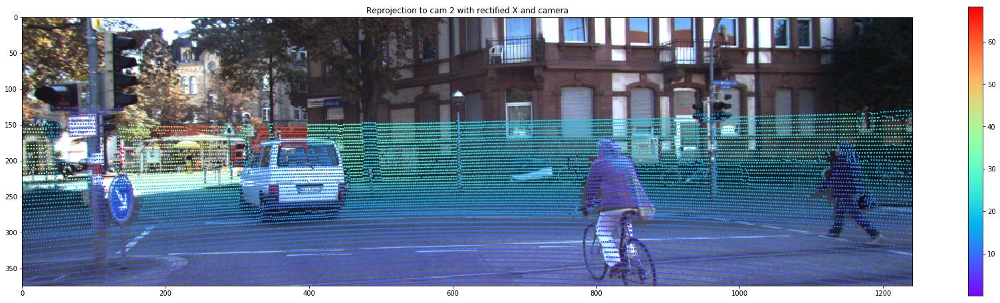

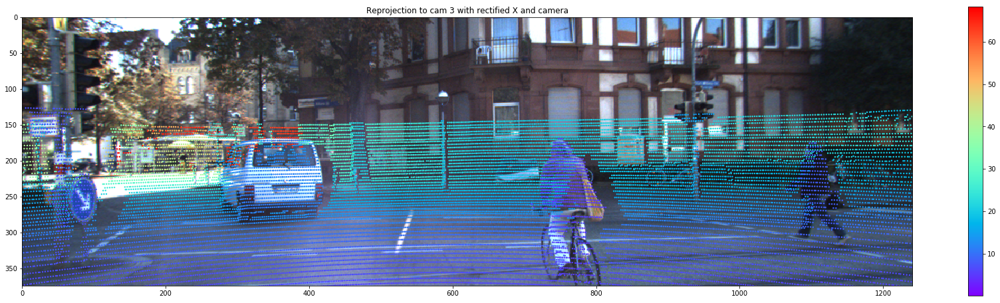

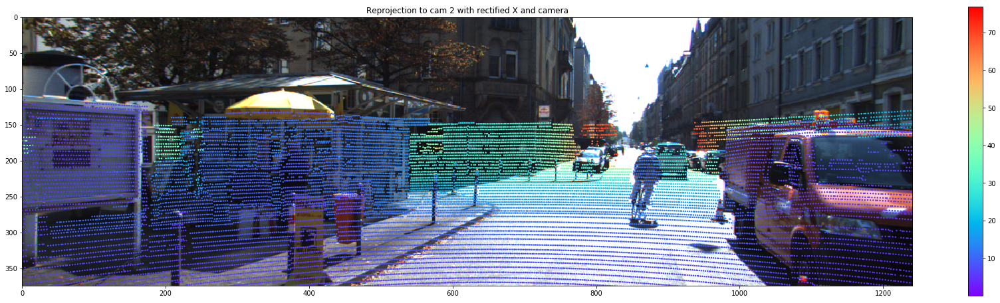

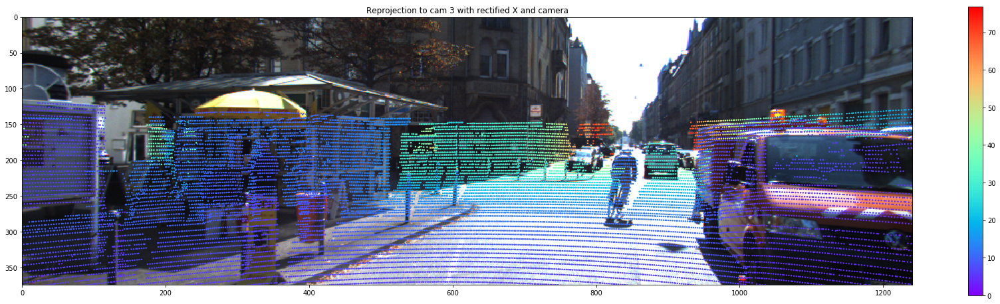

In [106]:
kitti_two_frame_loader.rectify_all(visualize=True)

## Get two frames

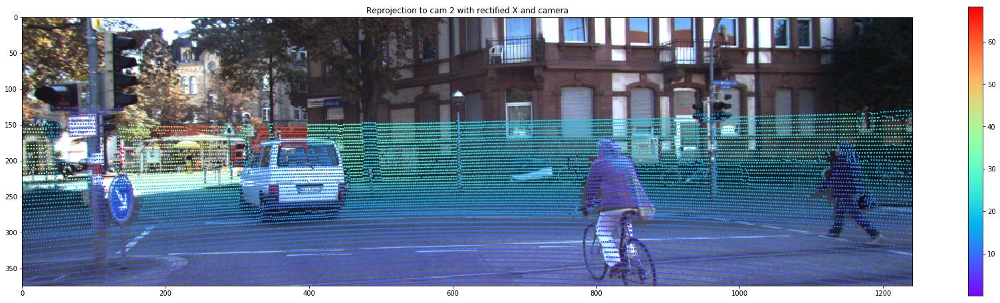

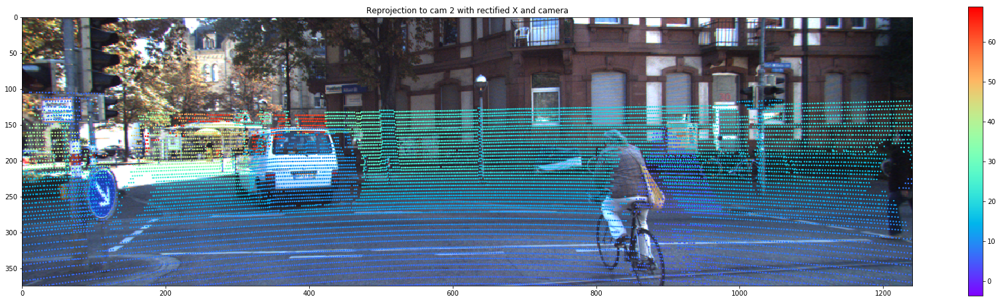

[[ 0.9992 -0.0021  0.0404 -0.0269]
 [ 0.0031  0.9997 -0.0235  0.0465]
 [-0.0403  0.0236  0.9989 -0.9918]]


In [239]:
%reload_ext autoreload
%autoreload 2
i = 0
j = 3

X_rect_i, X_rect_i_vis, delta_Rtij = kitti_two_frame_loader.get_ij(i, j, visualize=True)
print(delta_Rtij)

## Keypoint detection and matching with SIFT

# kps: 3420, descriptors: (3420, 128)


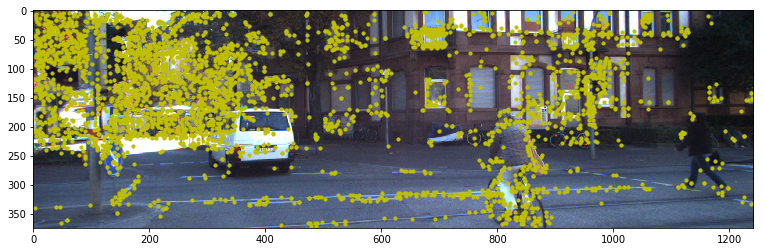

# kps: 3421, descriptors: (3421, 128)


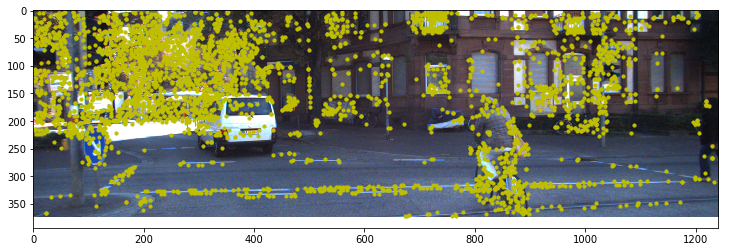

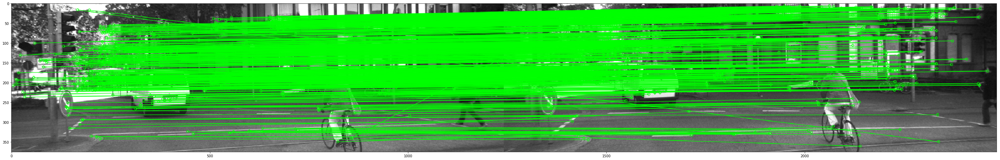

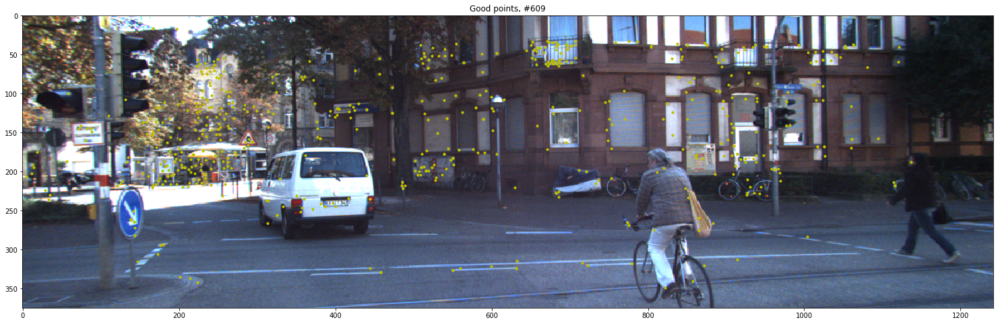

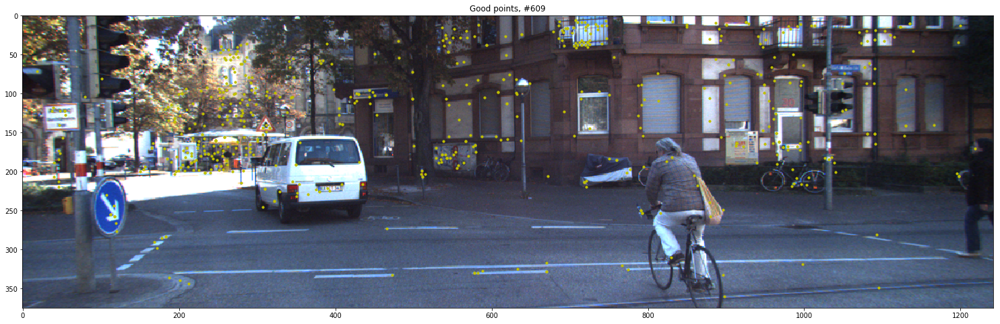

In [240]:
%reload_ext autoreload
%autoreload 2

img1_rgb, img2_rgb = kitti_two_frame_loader.dataset_rgb[i][0], kitti_two_frame_loader.dataset_rgb[j][0]
img1_rgb_np, img2_rgb_np = np.array(img1_rgb), np.array(img2_rgb)
img1, img2 = utils_opencv.PIL_to_gray(img1_rgb), utils_opencv.PIL_to_gray(img2_rgb)

x1_all, kp1, des1 = utils_opencv.SIFT_det(img1, img1_rgb, visualize=True)
x2_all, kp2, des2 = utils_opencv.SIFT_det(img2, img2_rgb, visualize=True)

x1, x2 = utils_opencv.KNN_match(des1, des2, x1_all, x2_all, kp1, kp2, img1_rgb, img2_rgb, visualize=True)

## Plot epipolar constraint by OpenCV and Rui's implementations

[[ 0.0012  0.9926  0.0232]
 [-0.9921  0.0027 -0.0132]
 [-0.0466 -0.0268 -0.0012]]


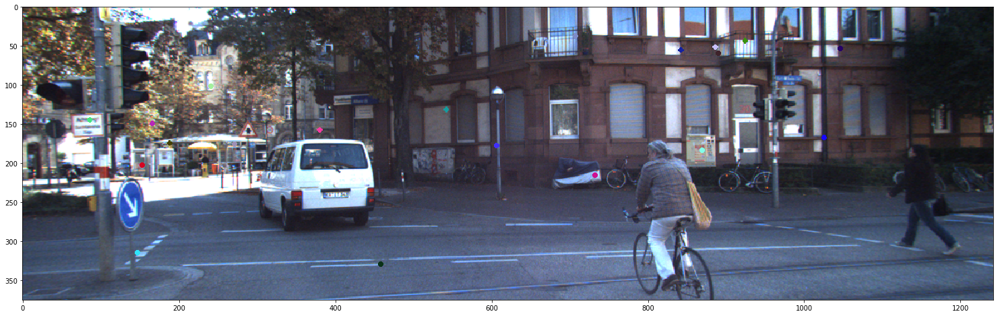

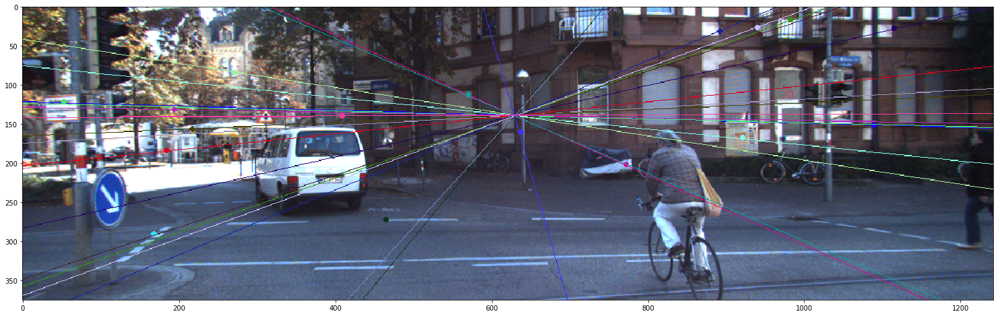

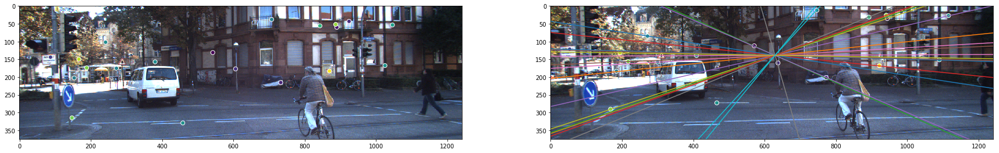

In [366]:
%reload_ext autoreload
%autoreload 2

E_gt_th, F_gt_th = utils_F._E_F_from_Rt(delta_Rtij[:, :3], delta_Rtij[:, 3:4], kitti_two_frame_loader.K)    
F_gt = F_gt_th.numpy()

R2s, t2s, M2s = utils_F._get_M2s(E_gt_th)
print(E_gt_th.numpy())

import random
random.seed(10)
N_points = 20
random_idx = random.sample(range(x1.shape[0]), N_points)
# random_idx = mask_index
x1_sample = x1[random_idx, :]
x2_sample = x2[random_idx, :]

## By OpenCV
utils_opencv.show_epipolar_opencv(x1_sample, x2_sample, img1_rgb, img2_rgb, F_gt)

## By Rui
utils_opencv.show_epipolar_rui(x1_sample, x2_sample, img1_rgb, img2_rgb, F_gt, kitti_two_frame_loader.im_shape)
    
# utils_vis.draw_corr(img1_rgb_np, img2_rgb_np, x1_sample, x2_sample, 2)

## Compute the Sampson distance
Multiplt View Geometry book, pg. 287, equ. 11.9, also https://github.com/marktao99/python/blob/master/CVP/samples/sfm.py#L216 ![image.png](https://ws3.sinaimg.cn/large/006tNc79ly1fzxju5m01oj3392070q4o.jpg)

[   0.2037   44.0133    0.9081    0.3166    0.1353    4.9955    0.0183
    0.1665    0.0247 1044.8554    0.0196    0.9512    0.0546    0.0029
    1.2065    0.0373    0.0588    1.1323    0.0564    0.5198]


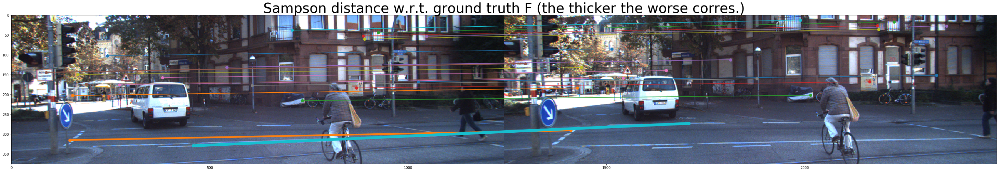

In [262]:
sampson_dist_gtF = utils_F._sampson_dist(F_gt_th, torch.from_numpy(x1_sample), torch.from_numpy(x2_sample), False)
print(sampson_dist_gtF.numpy())
sampson_dist_gtF_plot = np.log(sampson_dist_gtF.numpy()+1)+1

utils_vis.draw_corr_widths(img1_rgb_np, img2_rgb_np, x1_sample, x2_sample, sampson_dist_gtF_plot, 'Sampson distance w.r.t. ground truth F (the thicker the worse corres.)', False)

# DSAC

[0.     0.     0.     0.     0.     0.     0.0001 0.0001 0.0002 0.0003
 0.0003 0.0003 0.0004 0.0004 0.0004 0.0005 0.0006 0.0007 0.0007 0.0008]


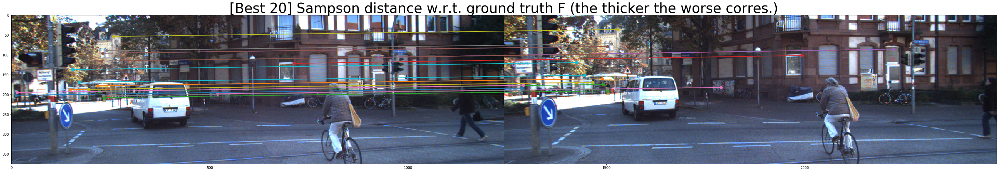

+++ E est&GT [[-0.0014 -0.9937 -0.0209]
 [ 0.9906 -0.0056  0.0454]
 [ 0.044  -0.007   0.0019]]
[[ 0.0012  0.9926  0.0232]
 [-0.9921  0.0027 -0.0132]
 [-0.0466 -0.0268 -0.0012]]
--- F est&GT [[-0.     -0.      0.0003]
 [ 0.     -0.     -0.0011]
 [-0.0003  0.0012 -0.0292]]
[[ 0.      0.     -0.0003]
 [-0.      0.      0.0011]
 [ 0.0003 -0.0012  0.0292]]


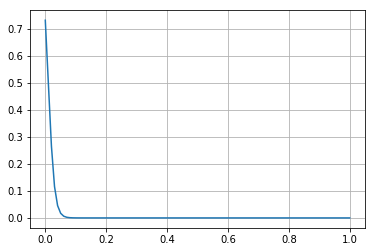

In [315]:
%reload_ext autoreload
%autoreload 2
np.set_printoptions(precision=4, suppress=True)

from dsac_tools.H_loss import HLoss
from dsac_tools.dsac import DSAC

from scipy.io import savemat

# Validation: use best 10 corres with smalles Sampson distance to GT F to compute E and F
errors = utils_F._sampson_dist(F_gt_th, torch.from_numpy(x1).to(torch.float64), torch.from_numpy(x2).to(torch.float64), False)
sort_index = np.argsort(errors.numpy())
mask_index = sort_index[:20]
print(errors[mask_index].numpy())

utils_vis.draw_corr_widths(img1_rgb_np, img2_rgb_np, x1[mask_index, :], x2[mask_index, :], np.zeros(x2[mask_index, :].shape[0])+2, '[Best 20] Sampson distance w.r.t. ground truth F (the thicker the worse corres.)', False)
E_est_th = utils_F._E_from_XY(torch.from_numpy(x1[mask_index, :]), torch.from_numpy(x2[mask_index, :]), kitti_two_frame_loader.K_th)
print('+++ E est&GT', (E_est_th / torch.norm(E_est_th) * torch.norm(E_gt_th)).numpy())
print(E_gt_th.numpy())

M2_list = utils_F._get_M2s(E_est_th)

F_est_th = utils_F._F_from_XY(torch.from_numpy(x1[mask_index, :]), torch.from_numpy(x2[mask_index, :]))
print('--- F est&GT', (F_est_th / torch.norm(F_est_th) * torch.norm(F_gt_th)).numpy())
print(F_gt)

inlier_beta = 100
inlier_thresh = 0.01 # HOW TO SET THRES?
a = torch.linspace(0, 1, 100)
b = 1 - torch.sigmoid(inlier_beta * (a - inlier_thresh))
plt.plot(a.numpy(), b.numpy())
plt.grid()
plt.show()

In [316]:
e = np.sort(errors.numpy().tolist())
print(len(e), sum(e<inlier_thresh), e)

609 86 [    0.         0.         0.         0.         0.         0.
     0.0001     0.0001     0.0002     0.0003     0.0003     0.0003
     0.0004     0.0004     0.0004     0.0005     0.0006     0.0007
     0.0007     0.0008     0.0008     0.0009     0.0009     0.001
     0.0012     0.0012     0.0012     0.0013     0.0015     0.0017
     0.0018     0.0018     0.0022     0.0025     0.0026     0.0028
     0.0028     0.0029     0.0029     0.0029     0.0029     0.0029
     0.003      0.003      0.0032     0.0032     0.0037     0.0041
     0.0051     0.0052     0.0053     0.0053     0.0054     0.0055
     0.0056     0.0057     0.0061     0.0063     0.0064     0.0066
     0.0067     0.0067     0.0069     0.0072     0.0072     0.0072
     0.0073     0.0075     0.0075     0.0078     0.0079     0.0079
     0.0081     0.0084     0.0084     0.0085     0.0087     0.0089
     0.009      0.0091     0.0093     0.0095     0.0095     0.0098
     0.0098     0.0098     0.0102     0.0103     0.0105     

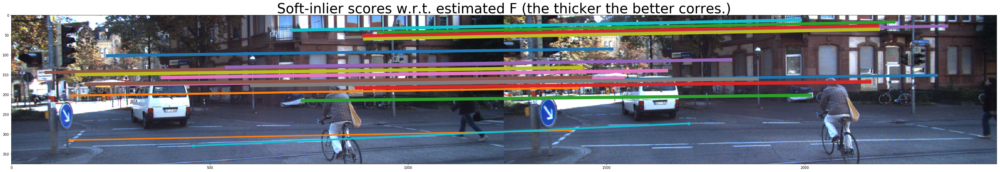

[[-0.     -0.      0.0003]
 [ 0.     -0.     -0.0011]
 [-0.0003  0.0011 -0.0292]]
[[ 0.      0.     -0.0003]
 [-0.      0.      0.0011]
 [ 0.0003 -0.0012  0.0292]]
[[-0.0022 -0.9925  0.0012]
 [ 0.9908 -0.0021  0.0701]
 [ 0.0219 -0.0309  0.0016]]
[[ 0.0012  0.9926  0.0232]
 [-0.9921  0.0027 -0.0132]
 [-0.0466 -0.0268 -0.0012]]


In [317]:
%reload_ext autoreload
%autoreload 2

from dsac_tools.H_loss import HLoss
from dsac_tools.dsac import DSAC
import dsac_tools.utils_F as utils_F
import torch

np.set_printoptions(precision=4, suppress=True)

N_hypotheses = 10000
# inlierthreshold = 0.05
# inlierbeta = 100.
inlier_alpha = 0.5

loss = HLoss()
dsac = DSAC(N_hypotheses, inlier_thresh, inlier_beta, inlier_alpha, loss)
N_scores = dsac(torch.from_numpy(x1), torch.from_numpy(x2), F_gt_th)
N_scores_np = N_scores.numpy()
N_scores_np = N_scores_np/np.max(N_scores_np)

utils_vis.draw_corr_widths(img1_rgb_np, img2_rgb_np, x1_sample, x2_sample, N_scores_np[random_idx]*10+1, 'Soft-inlier scores w.r.t. estimated F (the thicker the better corres.)', False)

F_est_th = dsac.best_H
best_corres_idx = dsac.best_corres_idx
print((F_est_th / torch.norm(F_est_th) * torch.norm(F_gt_th)).numpy())
print(F_gt)

E_est_th = utils_F._F_to_E(F_est_th, kitti_two_frame_loader.K_th)
print((E_est_th / torch.norm(E_est_th) * torch.norm(E_gt_th)).numpy())
print(E_gt_th.numpy())

In [352]:
%reload_ext autoreload
%autoreload 2

inlier_dists = dsac.sampson_dists.numpy()[dsac.best_H_idx, :]
# print(np.sort(inlier_dists.tolist()))
inlier_mask = inlier_dists < inlier_thresh
# print(np.sum(inlier_mask), inlier_mask.shape)
# print(inlier_thresh)
# print(errors.numpy()[inlier_mask])
M2_list = utils_F._E_to_M(E_est_th, kitti_two_frame_loader.K, x1, x2, inlier_mask, delta_Rtij[:, :3], delta_Rtij[:, 3:4])

[[ 0.9992 -0.0025  0.0396  0.031 ]
 [ 0.0034  0.9997 -0.0233  0.0221]
 [-0.0395  0.0234  0.9989 -0.9993]]
[  42.8494   41.8428    6.851     6.9879   37.8099   37.6221   49.355
   51.3604   71.8762   36.6248   38.3084   38.3084   39.6242   40.6341
   10.0717   41.879    10.7476   39.464    11.0453   11.0453   40.8545
   40.622    42.0528   48.1505   48.1505   43.3675   59.3401   42.4049
   44.9328   41.801    45.4416   54.4509   53.6749   48.318    47.4369
   39.3031   57.5024   40.3952   43.7397   43.9588   59.8569   59.8569
   44.0602   46.9511   59.1224   45.0453   72.2046   74.6233   74.6233
   47.0201   72.6195   72.7299   72.7299   66.4069   82.6041   38.3858
   69.2987   76.2443   71.3827   47.2851   62.3213   46.277    54.5257
   54.5257   69.579    52.2685   76.0267   49.1065   62.0569   48.0906
   46.2876   71.9636   62.0877   46.8264   62.2863   48.6498   67.4354
   51.118    47.8009   53.1249   24.1417   25.4529   24.4168   24.95
   24.95     23.8028   24.1959   25.4449   24

# [TODO] Check issues: outliers!

In [339]:
R2s, t2s, M2s = utils_F._get_M2s(E_est_th)

R1 = np.eye(3)
t1 = np.zeros((3, 1))
M1 = np.hstack((R1, t1))

cheirality_checks = []
M2_list = []
# for Rt_idx, M2 in enumerate(M2s):
Rt_idx = 1
M2 = M2s[Rt_idx].numpy()
R2 = M2[:, :3]
t2 = M2[:, 3:4]
print(M2, np.linalg.det(R2))

X_tri_homo = cv2.triangulatePoints(np.matmul(kitti_two_frame_loader.K, M1), np.matmul(kitti_two_frame_loader.K, M2), x1[inlier_mask].T, x2[inlier_mask].T)
X_tri = X_tri_homo[:3, :]/X_tri_homo[-1, :]
C1 = -np.matmul(R1, t1) # https://math.stackexchange.com/questions/82602/how-to-find-camera-position-and-rotation-from-a-4x4-matrix
cheirality1 = np.matmul(R1[2:3, :], (X_tri-C1)) # https://cmsc426.github.io/sfm/

X_tri_cam3 = np.matmul(R2, X_tri) + t2
C2 = -np.matmul(R2, t2)
cheirality2 = np.matmul(R2[2:3, :], (X_tri_cam3-C2))

print(cheirality1)
print(cheirality2)

#     cheirality_check = np.min(cheirality1)>0 and np.min(cheirality2)>0
#     cheirality_checks.append(cheirality_check)
#     if cheirality_check:
#         print(M2)
#         M2_list.append(M2)
#         print(X_tri[-1, :])
#         print(X_tri_cam3[-1, :])

outlier = cheirality2<0
print(outlier)

[[ 0.9992 -0.0025  0.0396  0.031 ]
 [ 0.0034  0.9997 -0.0233  0.0221]
 [-0.0395  0.0234  0.9989 -0.9993]] 1.0000000000000002
[[  42.8494   41.8428    6.851     6.9879   37.8099   37.6221   49.355
    51.3604   71.8762   36.6248   38.3084   38.3084   39.6242   40.6341
    10.0717   41.879    10.7476   39.464    11.0453   11.0453   40.8545
    40.622    42.0528   48.1505   48.1505   43.3675   59.3401   42.4049
    44.9328   41.801    45.4416   54.4509   53.6749   48.318    47.4369
    39.3031   57.5024   40.3952   43.7397   43.9588   59.8569   59.8569
    44.0602   46.9511   59.1224   45.0453   72.2046   74.6233   74.6233
    47.0201   72.6195   72.7299   72.7299   66.4069   82.6041   38.3858
    69.2987   76.2443   71.3827   47.2851   62.3213   46.277    54.5257
    54.5257   69.579    52.2685   76.0267   49.1065   62.0569   48.0906
    46.2876   71.9636   62.0877   46.8264   62.2863   48.6498   67.4354
    51.118    47.8009   53.1249   24.1417   25.4529   24.4168   24.95
    24.95     

In [342]:
print(M2)
print(delta_Rtij)
print(utils_geo.rot12_to_angle_error(M2[:, :3],  delta_Rtij[:, :3]))

[[ 0.9992 -0.0025  0.0396  0.031 ]
 [ 0.0034  0.9997 -0.0233  0.0221]
 [-0.0395  0.0234  0.9989 -0.9993]]
[[ 0.9992 -0.0021  0.0404 -0.0269]
 [ 0.0031  0.9997 -0.0235  0.0465]
 [-0.0403  0.0236  0.9989 -0.9918]]
0.051731531391599944


(1, 219)
[0.0003 0.001 ]


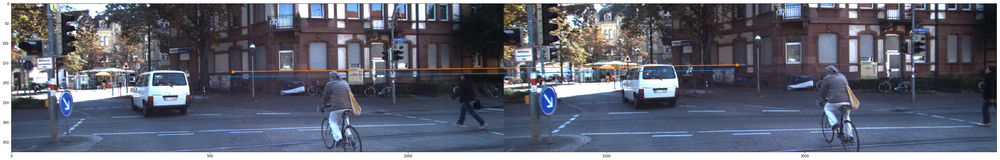

tensor([0.0275, 0.0315], dtype=torch.float64)
tensor([0.0003, 0.0010], dtype=torch.float64)
[[-12.0408 -50.8178]
 [  2.3738  -0.8336]
 [139.5749 711.8337]]
[[   9.1045    5.1531]
 [  -1.8091    0.0924]
 [-105.6248  -72.5481]]


In [351]:
outlier = cheirality2<0
print(cheirality2.shape)
o = outlier.reshape([-1])
print(inlier_dists[inlier_mask][o])
x1_outlier = x1[inlier_mask, :][o]
x2_outlier = x2[inlier_mask, :][o]
utils_vis.draw_corr_widths(img1_rgb_np, img2_rgb_np, x1_outlier, x2_outlier, np.zeros(o.shape[0])+2, '', False)

dist_gtF = utils_F._sampson_dist(F_gt_th, torch.from_numpy(x1_outlier), torch.from_numpy(x2_outlier))
print(dist_gtF)
est_gtF = utils_F._sampson_dist(F_est_th, torch.from_numpy(x1_outlier), torch.from_numpy(x2_outlier))
print(est_gtF)

X_tri_homo = cv2.triangulatePoints(np.matmul(kitti_two_frame_loader.K, M1), np.matmul(kitti_two_frame_loader.K, delta_Rtij), x1_outlier.T, x2_outlier.T)
X_tri = X_tri_homo[:3, :]/X_tri_homo[-1, :]
print(X_tri)
X_tri_homo = cv2.triangulatePoints(np.matmul(kitti_two_frame_loader.K, M1), np.matmul(kitti_two_frame_loader.K, M2), x1_outlier.T, x2_outlier.T)
X_tri = X_tri_homo[:3, :]/X_tri_homo[-1, :]
print(X_tri)

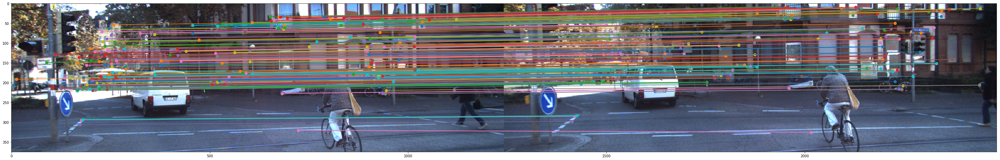

In [362]:
# utils_vis.draw_corr_widths(img1_rgb_np, img2_rgb_np, x1, x2, np.zeros(x1.shape[0]), '', False)
w = inlier_dists[inlier_mask]
w = w/np.max(w)*2+1
utils_vis.draw_corr_widths(img1_rgb_np, img2_rgb_np, x1[inlier_mask], x2[inlier_mask], w, '', False)

# With SuperPoint corres.

In [79]:
sp_results = np.load('dsac_tools/data/0000000000.npz')
print(x.files)
x1_sp = sp_results['keypoints1']
x2_sp = sp_results['keypoints2']
maches_sp = sp_results['matches']
x1 = maches_sp[:, :2]
x2 = maches_sp[:, 2:4]
print(x1_sp.shape, x2_sp.shape, maches_sp.shape)
print(x1.shape, x2.shape)

draw_corr_widths(img1_rgb, img2_rgb, x1, x2, np.zeros(x1.shape[0])+3, 'SuperPoint detection and correspondence', rescale=False)

errors = utils_F._sampson_dist(F_gt_th, torch.from_numpy(x1).to(torch.float64), torch.from_numpy(x2).to(torch.float64), False)
sort_index = np.argsort(errors.numpy())
mask_index = sort_index[:10]
print(errors[sort_index].numpy())

E_est_th = utils_F.E_from_XY(torch.from_numpy(x1[mask_index, :]), torch.from_numpy(x2[mask_index, :]))
print(E_gt_th.numpy())
print((E_est_th / torch.norm(E_est_th) * torch.norm(E_gt_th)).numpy())
R2s, t2s, M2s = utils_F._get_M2s(E_est_th)
print(M2s[0].numpy())

error_R = min([utils_F.rot12_to_angle_error(R2.numpy(), delta_R_gt) for R2 in R2s])
print('The rotation error of best 10 corres. w.r.t GT F (degree): ', error_R)

NameError: name 'x' is not defined

In [ ]:
%reload_ext autoreload
%autoreload 2

from dsac_tools.H_loss import HLoss
from dsac_tools.dsac import DSAC
import dsac_tools.utils_F as utils_F
import torch

N_hypotheses = 10000
inlierthreshold = 0.05
inlierbeta = 100.
inlieralpha = 0.5

loss = HLoss()
dsac = DSAC(N_hypotheses, inlierthreshold, inlierbeta, inlieralpha, loss)
N_scores = dsac(torch.from_numpy(x1), torch.from_numpy(x2), F_gt_th)
N_scores_np = N_scores.numpy()
N_scores_np = N_scores_np/np.max(N_scores_np)

draw_corr_widths(img1_rgb, img2_rgb, x1, x2, N_scores_np*5, 'Soft-inlier scores w.r.t. estimated F (the thicker the better corres.)', False)

F_est_th = dsac.best_H
best_corres_idx = dsac.best_corres_idx
# print((F_est_th / torch.norm(F_est_th) * torch.norm(F_gt_th)).numpy())
# print(F_gt)

E_est_th = utils_F._F_to_E(F_est_th, K_th)
print((E_est_th / torch.norm(E_est_th) * torch.norm(E_gt_th)).numpy())
print(E_gt_th.numpy())

R2s, t2s, M2s = utils_F._get_M2s(E_est_th)
# print([M2.numpy() for M2 in M2s])

R1 = np.eye(3)
t1 = np.zeros((3, 1))
M1 = np.hstack((R1, t1))

cheirality_checks = []
for Rt_idx, M2 in enumerate(M2s):
    M2 = M2.numpy()
    R2 = M2[:, :3]
    t2 = M2[:, 3:4]
    
    X_tri_homo = cv2.triangulatePoints(np.matmul(K, M1), np.matmul(K, M2), x1[best_corres_idx, :].T, x2[best_corres_idx, :].T)
    X_tri = X_tri_homo[:3, :]/X_tri_homo[-1, :]
    cheirality1 = np.matmul(R1[2:3, :], (X_tri-t1))
    
    X_tri_cam3 = np.matmul(R2, X_tri) + t2
    cheirality2 = np.matmul(R2[2:3, :], (X_tri-t2))
    cheirality_checks.append(np.min(cheirality1)>0 and np.min(cheirality2)>0)
    
    print('===========')
    print(M2)
    print('-----')
    print(cheirality1)
    print('-----')
    print(cheirality2)

if np.sum(cheirality_checks)==1:
    Rt_idx = cheirality_checks.index(True)
    print('The %d_th Rt meets the Cheirality Condition! with [R|t]:'%Rt_idx)
    print(M2s[Rt_idx].numpy())
else:
    print('Error! %d of qualified [R|t] found!'%np.sum(cheirality_checks))

error_R = min([utils_F.rot12_to_angle_error(R2.numpy(), delta_R_gt) for R2 in R2s])
print('The rotation error from RANSAC (degree): ', error_R)